# Twitter Sentiment Analysis

<img src="images/image2.jpg" alt="Negative, Neutral and Positive Emotions" width="800" height="200">

Authors: Augustine Komen, Fiona Amugune, Elizabeth Atieno, Neema Kezia, Peter Ronoh

### Table of Contents

[Data Exploration](#Data-Exploration)

[Data Cleaning](#Data-Cleaning)

[Exploratory Data Analysis](#Exploratory-Data-Analysis)

[Feature Engineering](#Feature-Engineering)

[Baseline model (Multinomial Naive Bayes)](#Baseline-model-(Multinomial-Naive-Bayes))

[Neural Networks](#Neural-Networks)

[Multi-Class Classification](#Multi-Class-Classification)

[Random Forest](#Random-Forest)

[XG Boost](#XG-Boost)

[Model Comparison](#Model-Comparison)

[Conclusions](#Conclusions)

[Recommendations](#Recommendations)

[Next Steps](#Next-Steps)

## Overview
Best Buy, a leading retailer of iPhone and Google products, aims to improve its inventory choices by analyzing user opinions on these items. This project utilizes sentiment analysis of Twitter data to understand customer views and preferences regarding iPhone and Google products. By examining user sentiments, Best Buy intends to make stocking decisions that match customer demand and boost overall satisfaction. The project involves gathering Twitter data on discussions, reviews, and mentions of iPhone and Google products, followed by data preprocessing and sentiment analysis. The insights gained will help Best Buy optimize its product selection and align it with customer preferences.

## Problem statement
Best Buy, a top reseller of iPhone and Google products, encounters difficulties in aligning its inventory with customer preferences. The lack of a structured approach to analyzing user sentiments on Twitter hinders data-driven stocking decisions. This project aims to utilize Twitter sentiment analysis to better understand customer opinions. By gaining insights into user sentiments, Best Buy aims to enhance its stocking decisions, ensuring product availability that matches customer preferences and improves overall customer satisfaction and loyalty.

## Business Value
By leveraging Twitter sentiment analysis to understand customer opinions, Best Buy will be able to make more informed stocking decisions leading to better allocation of resources, improved product assortment, enhanced customer satisfaction and profitability. By staying ahead of trends and understanding customer sentiments better than competitors, Best Buy can position itself as a preferred destination for purchasing iPhone and Google products.

## Objectives
The goal of this project is to analyse customer sentiments on Twitter to inform Best Buy's stocking decisions for iPhone and Google products. By analyzing customer opinions, the aim is to improve resource allocation, optimize product assortment, enhance customer satisfaction, and ultimately increase profitability.

## Research Questions
1. What are the predominant sentiments expressed by customers on Twitter regarding iPhone and Google products?

2. What factors influence the polarity of tweets related to iPhone and Google products on Twitter?

3. Which specific features of iPhone and Google products are most frequently praised or criticized by users on Twitter?

4. Which machine learning model is most effective in sentiment analysis?



## Data Understanding
The Present dataset contains a series of 9093 Tweets, the dataset has been pre-labeled by human raters. Raters judged if the tweet's text expressed a positive, negative or no emotion towards a brand and/or product, any time an emotion was expressed the rater was then asked to identify the brand or product that was the target of that emotion. All of this data was compiled into a CSV file labeled "judge-1377884607_tweet_product_company.csv" that can be found in the root of this repository.

The Tweets were in large part centered on Apple and Google products during/after the 2011 South by Southwest (SXSW) Conference. The resulting datafile contains three columns per row, one for the tweet's text, one for the emotion expressed and one for the target product/brand of that emotion, when identifiable.

The dataset contains 3 columns:

* `tweet:` anonymized tweets containing truncated hyperlinks
* `brand:` a label indicating whether the tweet contains a sentiment towards a product or company in particular
  * Apple
  * Apple products
  * Google
  * Android
  * None
* `emotion:` an assigned label indicating the sentiment of the tweet
  * Positive
  * Neutral
  * Negative
  * Cant tell

Data was sourced from CrowdFlower via data.world, added by Kent Cavender-Bares on August 30, 2013.

## Data Limitations
There were over 5000 missing values in the directed column. We were able to address this by imputing as many missing values as possible. The data set was also heavily imbalanced: overwhelmingly neutral with very few examples of negative sentiment.

For this project we will use accuracy as a metric in grading the models.

In [5]:
import pandas as pd

# Load the CSV file and load the first five entries of the dataset
df = pd.read_csv("data.csv", encoding="latin-1")
df.head()

,tweet_text,emotion_in_tweet_is_directed_at,is_there_an_emotion_directed_at_a_brand_or_product
0,.@wesley83 I have a 3G iPhone. After 3 hrs twe...,iPhone,Negative emotion
1,@jessedee Know about @fludapp ? Awesome iPad/i...,iPad or iPhone App,Positive emotion
2,@swonderlin Can not wait for #iPad 2 also. The...,iPad,Positive emotion
3,@sxsw I hope this year's festival isn't as cra...,iPad or iPhone App,Negative emotion
4,@sxtxstate great stuff on Fri #SXSW: Marissa M...,Google,Positive emotion


In [6]:
df.tail()

,tweet_text,emotion_in_tweet_is_directed_at,is_there_an_emotion_directed_at_a_brand_or_product
9088,Ipad everywhere. #SXSW {link},iPad,Positive emotion
9089,"Wave, buzz... RT @mention We interrupt your re...",NaN,No emotion toward brand or product
9090,"Google's Zeiger, a physician never reported po...",NaN,No emotion toward brand or product
9091,Some Verizon iPhone customers complained their...,NaN,No emotion toward brand or product
9092,Ï¡Ïàü_ÊÎÒ£Áââ_£â_ÛâRT @...,NaN,No emotion toward brand or product


The necessary libraries and fuctions that were used in this project were loaded in a separate notebook called `My_functions` that can be accesed inside this project's directory. `My_Functions` notebook was then imported into this notebook as shown below. 

In [7]:
import My_Functions as myf

## Data Exploration

In [8]:
#Loading the check_data function from My_Functions notebook
myf.check_data(df)

Shape of DataFrame:
(9093, 3)
Size of DataFrame:
27279
Info of DataFrame:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9093 entries, 0 to 9092
Data columns (total 3 columns):
 #   Column                                              Non-Null Count  Dtype 
---  ------                                              --------------  ----- 
 0   tweet_text                                          9092 non-null   object
 1   emotion_in_tweet_is_directed_at                     3291 non-null   object
 2   is_there_an_emotion_directed_at_a_brand_or_product  9093 non-null   object
dtypes: object(3)
memory usage: 213.2+ KB
None
Descriptive Statistics:
                                                   count unique  \
tweet_text                                          9092   9065   
emotion_in_tweet_is_directed_at                     3291      9   
is_there_an_emotion_directed_at_a_brand_or_product  9093      4   

                                                                                

## Summary of data
There are 9,093 records and 3 features. As there are only 9,065 unique tweets, it appears that there are some duplicates.

A little more than one third (3,291) of the tweets are identified as being directed at a particular product or brand associated with either Google or Apple, while the majority do not identify a product or brand.

Relatively few records have been identified as having a negative or "I can't tell" emotion.


## Data Cleaning

In [9]:
#Loading the data_cleaning function from my_functions notebook
myf.data_cleaning(df)

Data Types of Columns:
tweet_text                                            object
emotion_in_tweet_is_directed_at                       object
is_there_an_emotion_directed_at_a_brand_or_product    object
dtype: object

Column Names:
Index(['tweet_text', 'emotion_in_tweet_is_directed_at',
       'is_there_an_emotion_directed_at_a_brand_or_product'],
      dtype='object')

Unique Values in Each Column:
tweet_text: ['.@wesley83 I have a 3G iPhone. After 3 hrs tweeting at #RISE_Austin, it was dead!  I need to upgrade. Plugin stations at #SXSW.'
 "@jessedee Know about @fludapp ? Awesome iPad/iPhone app that you'll likely appreciate for its design. Also, they're giving free Ts at #SXSW"
 '@swonderlin Can not wait for #iPad 2 also. They should sale them down at #SXSW.'
 ...
 "Google's Zeiger, a physician never reported potential AE. Yet FDA relies on physicians. &quot;We're operating w/out data.&quot; #sxsw #health2dev"
 'Some Verizon iPhone customers complained their time fell back an hour

For the 5,802 records that don't identify a product or brand, about 9% of them were identified as having something other than "no emotion". Upon investigation of these, it appears that some of them mention "Apple" or "iPad" after all, so evidently some tweets have not been successfully associated with a product or brand.

The column names are a bit cumbersome, so we'll give them new names that are easier to deal with.

In [187]:
# Renaming the column names
df.columns = ['tweet', 'brand', 'emotion']
df.head()

,tweet,brand,emotion
0,.@wesley83 I have a 3G iPhone. After 3 hrs twe...,iPhone,Negative emotion
1,@jessedee Know about @fludapp ? Awesome iPad/i...,iPad or iPhone App,Positive emotion
2,@swonderlin Can not wait for #iPad 2 also. The...,iPad,Positive emotion
3,@sxsw I hope this year's festival isn't as cra...,iPad or iPhone App,Negative emotion
4,@sxtxstate great stuff on Fri #SXSW: Marissa M...,Google,Positive emotion


In [188]:
#Loading the analyze_data function from My_Functions notebook
myf.analyze_data(df)

Missing Values:
 tweet         1
brand      5802
emotion       0
dtype: int64

Duplicate Rows in the dataset:
 22


The line of code calls the `analyze_data` function from the `My_Functions` notebook on the dataframe `df`. The function then outputs information about missing values and duplicate rows in the dataset.
The output shows that there is `1` missing value in the `tweet` column, 5802 missing values in the brand column, and no missing values in the emotion column. Additionally, there are `22` duplicate rows in the dataset.

We will use the `dropna` method to remove rows with missing values in the tweet column, and `inplace=True` to make the changes directly to the dataframe without creating a copy. The `isna().sum()` method then will count the remaining missing values in each column.

In [189]:
#dropping the null values from tweet_text column
df.dropna(subset = ['tweet'], inplace = True)
df.isna().sum()

tweet         0
brand      5801
emotion       0
dtype: int64

Lets now check for duplicates in our df.
The following line of code identifies and extracts all duplicate rows in the dataframe by using the `duplicated` method with `keep=False`, which marks all duplicate rows as True.

In [190]:
duplicates = df[df.duplicated(keep=False)]
duplicates

,tweet,brand,emotion
7,"#SXSW is just starting, #CTIA is around the co...",Android,Positive emotion
9,Counting down the days to #sxsw plus strong Ca...,Apple,Positive emotion
17,I just noticed DST is coming this weekend. How...,iPhone,Negative emotion
20,Need to buy an iPad2 while I'm in Austin at #s...,iPad,Positive emotion
21,"Oh. My. God. The #SXSW app for iPad is pure, u...",iPad or iPhone App,Positive emotion
24,Really enjoying the changes in Gowalla 3.0 for...,Android App,Positive emotion
466,"Before It Even Begins, Apple Wins #SXSW {link}",Apple,Positive emotion
468,"Before It Even Begins, Apple Wins #SXSW {link}",Apple,Positive emotion
774,Google to Launch Major New Social Network Call...,NaN,No emotion toward brand or product
776,Google to Launch Major New Social Network Call...,NaN,No emotion toward brand or product


In [ ]:
#dropping the duplicates
df.drop_duplicates(inplace=True)

This line of code drops all duplicate rows from the dataframe using the `drop_duplicates` method, with `inplace=True` to make changes directly to the dataframe.

In [192]:
# reviewing values for target data
df.emotion.value_counts(dropna=False)

No emotion toward brand or product    5375
Positive emotion                      2970
Negative emotion                       569
I can't tell                           156
Name: emotion, dtype: int64

This code counts the occurrences of each unique value in the emotion column, including missing values (NaN).
This shows the distribution of emotions in the dataset, with the majority having "No emotion toward brand or product."

In [193]:
#Keep Missing Brands for General Sentiment Analysis
df['brand'].fillna('No Brand', inplace=True)
df['brand']

0                   iPhone
1       iPad or iPhone App
2                     iPad
3       iPad or iPhone App
4                   Google
               ...        
9088                  iPad
9089              No Brand
9090              No Brand
9091              No Brand
9092              No Brand
Name: brand, Length: 9070, dtype: object

This code fills missing values in the brand column with the string "No Brand" and updates the dataframe in place.
The output shows that missing brand values have been replaced with "No Brand."

In [194]:
#Change 'No emotion toward brand or product' to 'Neutral emotion' and 'I can't tell' to ambiguous 

emotion_map = {"No emotion toward brand or product": "Neutral", 
              "Positive emotion": "Positive",
              "Negative emotion": "Negative",
              "I can't tell":"Ambiguous"}

df.emotion = df.emotion.map(emotion_map)
df.emotion.value_counts()

Neutral      5375
Positive     2970
Negative      569
Ambiguous     156
Name: emotion, dtype: int64

This code creates a dictionary `emotion_map` to rename the emotion labels and applies this mapping to the emotion column. It then counts the occurrences of each new value.

In [195]:
# check the value counts for column tweet_product 
df.brand.value_counts(dropna=False)

No Brand                           5788
iPad                                945
Apple                               659
iPad or iPhone App                  469
Google                              428
iPhone                              296
Other Google product or service     293
Android App                          80
Android                              77
Other Apple product or service       35
Name: brand, dtype: int64

#### Cleans the column "tweet" by removing:
    - Punctuation and special characters
    - Email addresses
    - Links (URLs)
    - Numbers
    - Mentions (@username)
    - Hashtags (#hashtag)
    - Converts the text to lowercase
    - Removes extra spaces
    - Removes the dollar sign ('$')

In [196]:
from My_Functions import clean_tweet

df['tweet'] = df['tweet'].apply(clean_tweet)
df.head(15)

,tweet,brand,emotion
0,i have a g iphone after hrs tweeting at rise_a...,iPhone,Negative
1,know about awesome ipadiphone app that youll l...,iPad or iPhone App,Positive
2,can not wait for ipad also they should sale th...,iPad,Positive
3,i hope this years festival isnt as crashy as t...,iPad or iPhone App,Negative
4,great stuff on fri sxsw marissa mayer google t...,Google,Positive
5,new ipad apps for speechtherapy and communicat...,No Brand,Neutral
7,sxsw is just starting ctia is around the corne...,Android,Positive
8,beautifully smart and simple idea rt wrote abo...,iPad or iPhone App,Positive
9,counting down the days to sxsw plus strong can...,Apple,Positive
10,excited to meet the at sxsw so i can show them...,Android,Positive


Now we will replace various brand names related to Apple and Google with the unified labels "Apple" and "Google". 
After that, we fill any missing values in the brand column with "other".

In [197]:
#Assign either "apple" or "google" label and fill in values that have no brand with "No Brand"
df['brand'].replace(['iPad', 'Apple', 'iPad or iPhone App', 'iPhone', 'Other Apple product or service'], 'Apple',
                     inplace=True)
df['brand'].replace(['Google', 'Other Google product or service', 'Android App', 'Android'], 'Google',
                     inplace=True)
df['brand'].fillna('other', inplace=True)


# show breakdown of brand after merging
df.brand.value_counts()

No Brand    5788
Apple       2404
Google       878
Name: brand, dtype: int64

In [198]:
# Value counts for categorical columns (like brand and emotion)
df['emotion'].value_counts()

Neutral      5375
Positive     2970
Negative      569
Ambiguous     156
Name: emotion, dtype: int64

Next we will import the `assign_brand` function from the `My_Functions` module and apply it to each row of the dataframe to assign brands. Then we use the df.head() function to show the first few entries of the updated dataframe.

In [199]:
#Assigning names to corresponding brands
from My_Functions import assign_brand

# Apply the assign_brand function to your DataFrame
df['brand'] = df.apply(myf.assign_brand, axis=1)

# Display the updated DataFrame
df.head()


,tweet,brand,emotion
0,i have a g iphone after hrs tweeting at rise_a...,Apple,Negative
1,know about awesome ipadiphone app that youll l...,Apple,Positive
2,can not wait for ipad also they should sale th...,Apple,Positive
3,i hope this years festival isnt as crashy as t...,Apple,Negative
4,great stuff on fri sxsw marissa mayer google t...,Google,Positive


This shows the first few entries of the updated dataframe where the brand column now has the corresponding brand names assigned.

The next lines of code count the occurrences of each unique value in the emotion column for entries where the brand is "Apple" and "Google".

In [200]:
df[df.brand == 'Apple'].emotion.value_counts()

Positive     1945
Negative      387
Neutral        65
Ambiguous       7
Name: emotion, dtype: int64

In [201]:
df[df.brand == 'Google'].emotion.value_counts()

Positive     719
Negative     131
Neutral       26
Ambiguous      2
Name: emotion, dtype: int64

This shows the distribution of emotions for entries where the brand is "Apple" and "Google", with "Positive" being the most common emotion for both brands.

## Exploratory Data Analysis

### Univariate Analysis

The `myf.run_univariate_analysis(df)` function conducts a univariate analysis on the dataframe `df`. This typically involves analyzing each variable independently.

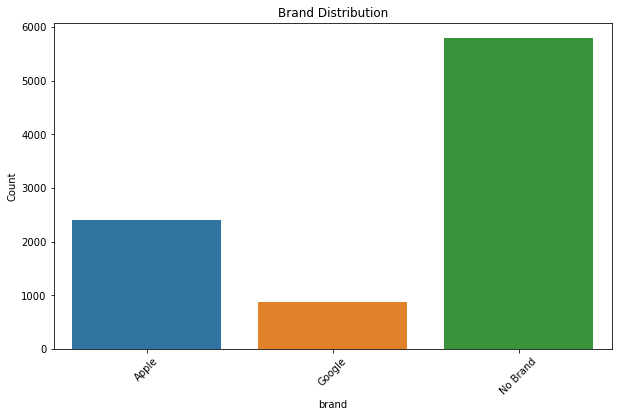

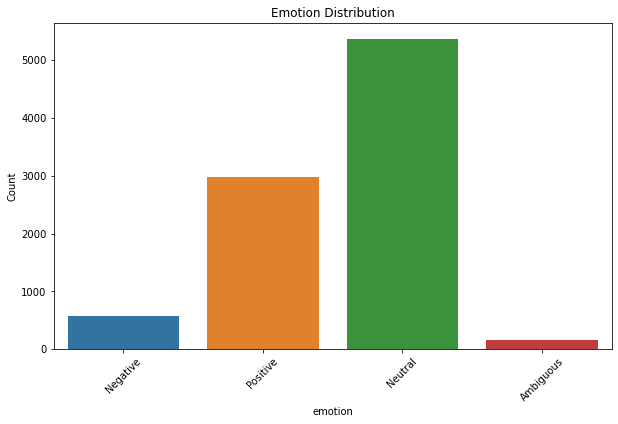

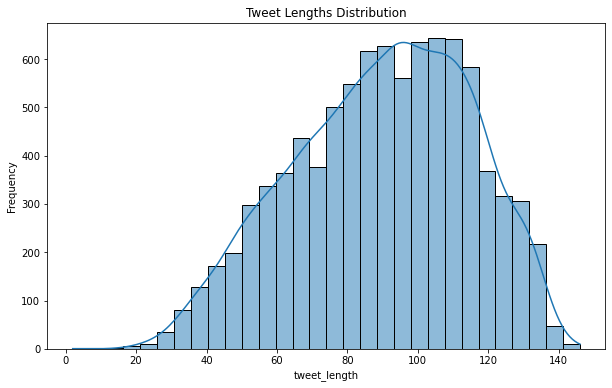

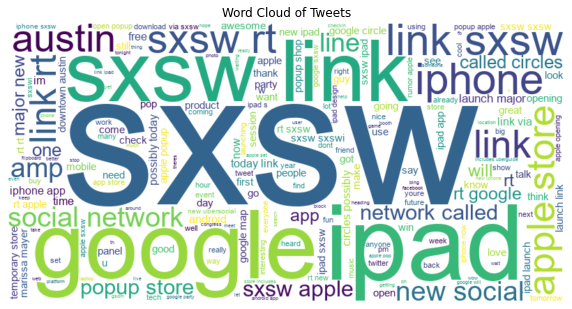

In [202]:
#Analyzing distribution of brands and emotions in tweets,tweet length distribution, brand value counts and emotional counts.
myf.run_univariate_analysis(df)


### Observations From the graphs:
##### 1.  Brand Distribution(First Graph)
The `"No Brand"` category has the highest count, close to 6000. This indicates that a significant portion of the dataset consists of unbranded products.
The `"Apple"` brand has the second-highest count, slightly above 2000. This suggests a strong presence and popularity of Apple products within the dataset.
The `"Google"` brand has the lowest count, slightly above 1000. While it has a notable presence, it is less prevalent compared to Apple and the "No Brand" category.

##### 2. Emotion Distribution (Second Graph):
The majority of the data is categorized as `"Neutral,"` followed by `"Positive"` emotions.
There is a significantly lower count of `"Negative"` and `"Ambiguous"` emotions.
- Insight: Most tweets exhibit neutral sentiment, indicating that the dataset may have a majority of tweets with objective or balanced tones.

##### 3. Tweet Length Distribution (Third Graph):
The distribution of tweet lengths is approximately normal, with the majority of tweets falling between 60 and 100 characters.
- Insight: Tweets tend to have a concise length, suggesting that most users stay within a typical range of brevity for communication.

##### 4. Word Cloud (Fourth Graph):
Prominent words like "SXSW," "Google," "iPhone," and "Austin" appear frequently, indicating that the dataset might revolve around discussions or events related to the South by Southwest (SXSW) festival, technology, and related products.
- Insight: The dataset contains specific themes or topics, likely focusing on technology and events, which may influence the overall sentiment distribution.

#### General Observation:
The dataset appears to be well-structured around specific themes, with a strong presence of neutral and positive sentiment. This suggests a balanced dataset with a focus on objective or constructive discussions, possibly related to technology and events like SXSW. The word cloud emphasizes recurring topics, which could help refine the analysis for targeted insights.

### Bivariate Analysis

The `myf.run_bivariate_analysis(df)` function performs a bivariate analysis on the dataframe `df`. This typically involves examining the relationships between two variables at a time.

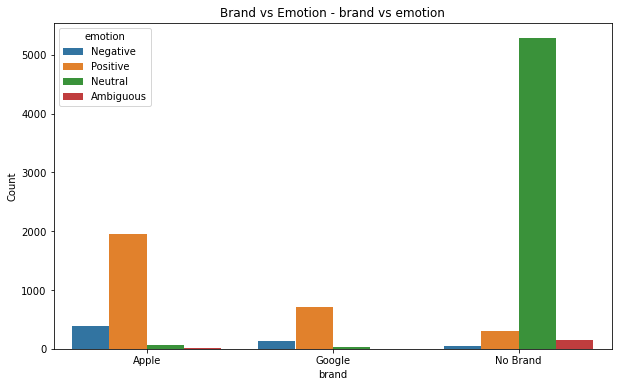

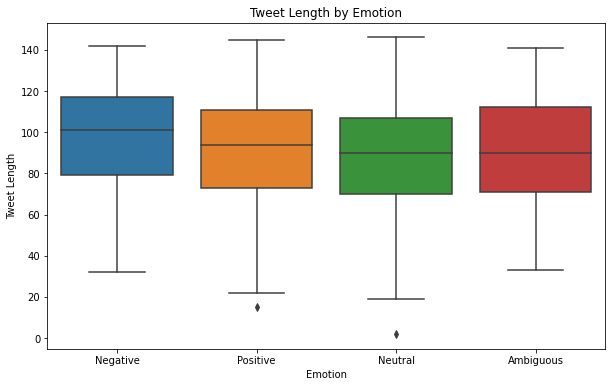

In [203]:
# Function to plot and analyse the brand and emotion distribution as well as distribution of tweet length by emotion
myf.run_bivariate_analysis(df)

### Observation from the graphs:
##### 1. Brand vs Emotion Graph:
The distribution of emotions across these brands provides insights into how people feel about them. For Apple and Google, Positive emotions are predominant, indicating favorable sentiment. The high count of Neutral emotions for the No Brand category might suggest ambivalence or non-specific sentiment.

##### 2. Tweet Length by Emotion Graph:
The graph shows the distribution of tweet lengths across four different emotion categories: Negative, Positive, Neutral, and Ambiguous. Each box plot displays the range of tweet lengths, including the median, quartiles, and any potential outliers.

Key observations:

**Median Tweet Length:**
The median tweet length is similar across all four emotion categories, indicating that the central tendency of tweet lengths does not vary significantly with the emotional content.

**Variability:**
All four emotion categories exhibit a wide range of tweet lengths, with lengths spanning from very short to the maximum character limit of 140.

**Outliers:**
Outliers are present in all emotion categories, suggesting that there are tweets with lengths that are significantly different from the majority. These could be extremely long or short tweets.

## Tockenizing

### 1. Creating word tokens

In [204]:
from My_Functions import tokenize

df['word_tokens'] = df['tweet'].apply(tokenize)
df.head()

,tweet,brand,emotion,tweet_length,word_tokens
0,i have a g iphone after hrs tweeting at rise_a...,Apple,Negative,105,"[iphone, hrs, tweeting, dead, need, upgrade, p..."
1,know about awesome ipadiphone app that youll l...,Apple,Positive,112,"[know, awesome, ipadiphone, app, youll, likely..."
2,can not wait for ipad also they should sale th...,Apple,Positive,61,"[wait, ipad, also, sale, sxsw]"
3,i hope this years festival isnt as crashy as t...,Apple,Negative,71,"[hope, years, festival, isnt, crashy, years, i..."
4,great stuff on fri sxsw marissa mayer google t...,Google,Positive,107,"[great, stuff, fri, sxsw, marissa, mayer, goog..."


### Stemming and lemmatization

In [205]:
# stemming and lemmatization
from nltk.stem import WordNetLemmatizer, PorterStemmer
from nltk.tokenize import word_tokenize
import nltk

nltk.download('wordnet')
lemmatizer = WordNetLemmatizer()
stemmer = PorterStemmer()

def lemmatize(tokens):
    return [lemmatizer.lemmatize(t) for t in tokens]

def stem(tokens):
    return [stemmer.stem(t) for t in tokens]

df['stemmed'] = df['word_tokens'].apply(stem)
df['lemmatized'] = df['word_tokens'].apply(lemmatize)

df.head()

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Kaysen\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


,tweet,brand,emotion,tweet_length,word_tokens,stemmed,lemmatized
0,i have a g iphone after hrs tweeting at rise_a...,Apple,Negative,105,"[iphone, hrs, tweeting, dead, need, upgrade, p...","[iphon, hr, tweet, dead, need, upgrad, plugin,...","[iphone, hr, tweeting, dead, need, upgrade, pl..."
1,know about awesome ipadiphone app that youll l...,Apple,Positive,112,"[know, awesome, ipadiphone, app, youll, likely...","[know, awesom, ipadiphon, app, youll, like, ap...","[know, awesome, ipadiphone, app, youll, likely..."
2,can not wait for ipad also they should sale th...,Apple,Positive,61,"[wait, ipad, also, sale, sxsw]","[wait, ipad, also, sale, sxsw]","[wait, ipad, also, sale, sxsw]"
3,i hope this years festival isnt as crashy as t...,Apple,Negative,71,"[hope, years, festival, isnt, crashy, years, i...","[hope, year, festiv, isnt, crashi, year, iphon...","[hope, year, festival, isnt, crashy, year, iph..."
4,great stuff on fri sxsw marissa mayer google t...,Google,Positive,107,"[great, stuff, fri, sxsw, marissa, mayer, goog...","[great, stuff, fri, sxsw, marissa, mayer, goog...","[great, stuff, fri, sxsw, marissa, mayer, goog..."


In [206]:
from nltk.corpus import stopwords
nltk.download('stopwords')
stop_words = set(stopwords.words('english'))

def remove_stopwords(tokens):
    return [word for word in tokens if word not in stop_words]
df['clean_tokens'] = df['word_tokens'].apply(remove_stopwords)
df.head()

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Kaysen\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


,tweet,brand,emotion,tweet_length,word_tokens,stemmed,lemmatized,clean_tokens
0,i have a g iphone after hrs tweeting at rise_a...,Apple,Negative,105,"[iphone, hrs, tweeting, dead, need, upgrade, p...","[iphon, hr, tweet, dead, need, upgrad, plugin,...","[iphone, hr, tweeting, dead, need, upgrade, pl...","[iphone, hrs, tweeting, dead, need, upgrade, p..."
1,know about awesome ipadiphone app that youll l...,Apple,Positive,112,"[know, awesome, ipadiphone, app, youll, likely...","[know, awesom, ipadiphon, app, youll, like, ap...","[know, awesome, ipadiphone, app, youll, likely...","[know, awesome, ipadiphone, app, youll, likely..."
2,can not wait for ipad also they should sale th...,Apple,Positive,61,"[wait, ipad, also, sale, sxsw]","[wait, ipad, also, sale, sxsw]","[wait, ipad, also, sale, sxsw]","[wait, ipad, also, sale, sxsw]"
3,i hope this years festival isnt as crashy as t...,Apple,Negative,71,"[hope, years, festival, isnt, crashy, years, i...","[hope, year, festiv, isnt, crashi, year, iphon...","[hope, year, festival, isnt, crashy, year, iph...","[hope, years, festival, isnt, crashy, years, i..."
4,great stuff on fri sxsw marissa mayer google t...,Google,Positive,107,"[great, stuff, fri, sxsw, marissa, mayer, goog...","[great, stuff, fri, sxsw, marissa, mayer, goog...","[great, stuff, fri, sxsw, marissa, mayer, goog...","[great, stuff, fri, sxsw, marissa, mayer, goog..."


In [207]:
def join_tokens(tokens):
    return ' '.join(tokens)
df['processed_text'] = df['clean_tokens'].apply(join_tokens)
df.style.set_properties(**{'text-align': 'left'})

In [208]:
from collections import Counter

# Function to count word frequencies in the text
def count_words(text):
    words = text.split() 
    return Counter(words)

# Count word frequencies for each tweet
df['word_freq'] = df['processed_text'].apply(count_words)

# Group by emotion and aggregate word frequencies
word_frequencies_by_emotion = df.groupby('emotion')['word_freq'].apply(lambda x: sum(x, Counter()))

# Check the new index
print(word_frequencies_by_emotion.index)

MultiIndex([('Ambiguous',          'thanks'),
            ('Ambiguous',      'publishing'),
            ('Ambiguous',            'news'),
            ('Ambiguous',             'new'),
            ('Ambiguous',         'medical'),
            ('Ambiguous',            'apps'),
            ('Ambiguous',           'sxswi'),
            ('Ambiguous',            'conf'),
            ('Ambiguous',            'blog'),
            ('Ambiguous',            'link'),
            ...
            ( 'Positive',            'tmrw'),
            ( 'Positive',         'padless'),
            ( 'Positive',             'bmm'),
            ( 'Positive',   'sxswmymistake'),
            ( 'Positive',         'hooting'),
            ( 'Positive',           'cords'),
            ( 'Positive',        'princess'),
            ( 'Positive', 'quotpapyrussort'),
            ( 'Positive',         'lavelle'),
            ( 'Positive',      'stabilizer')],
           names=['emotion', None], length=40072)


Processing emotion: Ambiguous
Top words for Ambiguous:        word  count
10     sxsw  156.0
9      link   48.0
58     ipad   47.0
24   google   44.0
34    apple   35.0
50   iphone   31.0
15    store   22.0
16   austin   16.0
30  circles   16.0
27   social   12.0
Processing emotion: Negative
Top words for Negative:        word  count
10     sxsw  575.0
58     ipad  194.0
50   iphone  155.0
24   google  140.0
9      link  101.0
34    apple   99.0
144     app   60.0
15    store   44.0
3       new   43.0
306    like   39.0
Processing emotion: Neutral
Top words for Neutral:        word   count
10     sxsw  5626.0
9      link  2913.0
24   google  1506.0
58     ipad  1427.0
34    apple  1174.0
15    store   862.0
50   iphone   807.0
3       new   671.0
16   austin   624.0
446     amp   523.0
Processing emotion: Positive
Top words for Positive:        word   count
10     sxsw  3073.0
9      link  1206.0
58     ipad  1188.0
34    apple   835.0
24   google   634.0
15    store   538.0
50   iphon

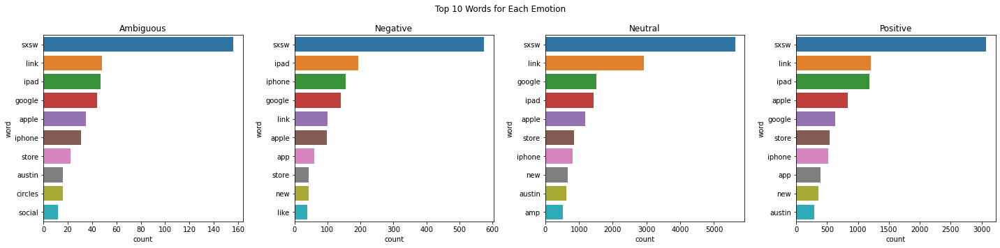

In [209]:
def get_top_n_words(emotion, n=10):
    # Filter the Series for the specific emotion
    emotion_words = word_frequencies_by_emotion.loc[emotion]
    
    # Convert to a DataFrame for easier manipulation
    emotion_df = emotion_words.reset_index()
    emotion_df.columns = ['word', 'count']  # Rename columns for clarity

    # Get the top N words
    top_words = emotion_df.nlargest(n, 'count')
    
    print(f"Top words for {emotion}: {top_words}")  
    return top_words  # Return the DataFrame for further use

# Step 4: Create Visualizations for Each Emotion
emotions = word_frequencies_by_emotion.index.levels[0]  # Get unique emotions
num_emotions = len(emotions)

fig, axes = plt.subplots(1, num_emotions, figsize=(5 * num_emotions, 5))

for index, emotion in enumerate(emotions):
    print(f"Processing emotion: {emotion}")
    
    # Get top 10 words for the current emotion
    top_words_df = get_top_n_words(emotion, 10)
    
    # Plotting
    sns.barplot(x='count', y='word', data=top_words_df, ax=axes[index]).set_title(emotion)

plt.suptitle('Top 10 Words for Each Emotion')
plt.tight_layout()
plt.savefig('top_words_by_emotion.png')
plt.show()

From the graphs above:
- The word frequencies in the Neutral category are significantly higher than in other categories, suggesting that the dataset is skewed toward neutral or factual sentiment rather than strong opinions.
- The prominence of terms like "sxsw," "apple," "google," and "iphone" across categories indicates that the dataset is heavily focused on technology-related discussions, possibly centered around an event (likely SXSW).

## Feature Engineering

In [210]:
# Perform feature engineering
# Filter the dataset for only positive and negative sentiments
binary_df = df[df['emotion'].isin(['Positive', 'Negative'])].copy() 

# Prepare target variable (1 for Positive, 0 for Negative)
binary_df["y_binary"] = binary_df['emotion'].apply(lambda x: 1 if x == 'Positive' else 0)

binary_df

,tweet,brand,emotion,tweet_length,word_tokens,stemmed,lemmatized,clean_tokens,processed_text,word_freq,y_binary
0,i have a g iphone after hrs tweeting at rise_a...,Apple,Negative,105,"[iphone, hrs, tweeting, dead, need, upgrade, p...","[iphon, hr, tweet, dead, need, upgrad, plugin,...","[iphone, hr, tweeting, dead, need, upgrade, pl...","[iphone, hrs, tweeting, dead, need, upgrade, p...",iphone hrs tweeting dead need upgrade plugin s...,"{'iphone': 1, 'hrs': 1, 'tweeting': 1, 'dead':...",0
1,know about awesome ipadiphone app that youll l...,Apple,Positive,112,"[know, awesome, ipadiphone, app, youll, likely...","[know, awesom, ipadiphon, app, youll, like, ap...","[know, awesome, ipadiphone, app, youll, likely...","[know, awesome, ipadiphone, app, youll, likely...",know awesome ipadiphone app youll likely appre...,"{'know': 1, 'awesome': 1, 'ipadiphone': 1, 'ap...",1
2,can not wait for ipad also they should sale th...,Apple,Positive,61,"[wait, ipad, also, sale, sxsw]","[wait, ipad, also, sale, sxsw]","[wait, ipad, also, sale, sxsw]","[wait, ipad, also, sale, sxsw]",wait ipad also sale sxsw,"{'wait': 1, 'ipad': 1, 'also': 1, 'sale': 1, '...",1
3,i hope this years festival isnt as crashy as t...,Apple,Negative,71,"[hope, years, festival, isnt, crashy, years, i...","[hope, year, festiv, isnt, crashi, year, iphon...","[hope, year, festival, isnt, crashy, year, iph...","[hope, years, festival, isnt, crashy, years, i...",hope years festival isnt crashy years iphone a...,"{'hope': 1, 'years': 2, 'festival': 1, 'isnt':...",0
4,great stuff on fri sxsw marissa mayer google t...,Google,Positive,107,"[great, stuff, fri, sxsw, marissa, mayer, goog...","[great, stuff, fri, sxsw, marissa, mayer, goog...","[great, stuff, fri, sxsw, marissa, mayer, goog...","[great, stuff, fri, sxsw, marissa, mayer, goog...",great stuff fri sxsw marissa mayer google tim ...,"{'great': 1, 'stuff': 1, 'fri': 1, 'sxsw': 1, ...",1
...,...,...,...,...,...,...,...,...,...,...,...
9077,your pr guy just convinced me to switch back t...,Apple,Positive,83,"[guy, convinced, switch, back, iphone, great, ...","[guy, convinc, switch, back, iphon, great, sxs...","[guy, convinced, switch, back, iphone, great, ...","[guy, convinced, switch, back, iphone, great, ...",guy convinced switch back iphone great sxsw co...,"{'guy': 1, 'convinced': 1, 'switch': 1, 'back'...",1
9079,quotpapyrussort of like the ipadquot nice lol ...,Apple,Positive,58,"[quotpapyrussort, like, ipadquot, nice, lol, s...","[quotpapyrussort, like, ipadquot, nice, lol, s...","[quotpapyrussort, like, ipadquot, nice, lol, s...","[quotpapyrussort, like, ipadquot, nice, lol, s...",quotpapyrussort like ipadquot nice lol sxsw la...,"{'quotpapyrussort': 1, 'like': 1, 'ipadquot': ...",1
9080,diller says google tv quotmight be run over by...,Google,Negative,125,"[diller, says, google, quotmight, run, playsta...","[diller, say, googl, quotmight, run, playstat,...","[diller, say, google, quotmight, run, playstat...","[diller, says, google, quotmight, run, playsta...",diller says google quotmight run playstation x...,"{'diller': 2, 'says': 1, 'google': 1, 'quotmig...",0
9085,ive always used camera for my iphone bc it has...,Apple,Positive,129,"[ive, always, used, camera, iphone, image, sta...","[ive, alway, use, camera, iphon, imag, stabil,...","[ive, always, used, camera, iphone, image, sta...","[ive, always, used, camera, iphone, image, sta...",ive always used camera iphone image stabilizer...,"{'ive': 1, 'always': 1, 'used': 1, 'camera': 1...",1


## Modelling

Import the necessary libraries for modelling

In [211]:
# importing necessary libraries
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score, classification_report
from sklearn.preprocessing import LabelEncoder

We'll split the data into train and test sets.

In [212]:
X = binary_df['processed_text']  
y = binary_df['y_binary']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

## 1. Baseline model (Multinomial Naive Bayes)

In [213]:
# Initialize the vectorizer and model
vectorizer = TfidfVectorizer()
base_model = MultinomialNB()

# Vectorizing the training data
X_train_vectorized = vectorizer.fit_transform(X_train)

# Vectorizing the test data
X_test_vectorized = vectorizer.transform(X_test)

# Fitting the model to the training data
base_model.fit(X_train_vectorized, y_train)

# Making predictions on the test data
y_pred = base_model.predict(X_test_vectorized)

# Calculate accuracy and print the classification report
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.2f}')
print(classification_report(y_test, y_pred))

Accuracy: 0.86
              precision    recall  f1-score   support

           0       1.00      0.07      0.12       106
           1       0.86      1.00      0.92       602

    accuracy                           0.86       708
   macro avg       0.93      0.53      0.52       708
weighted avg       0.88      0.86      0.80       708



- The baseline model achieved an accuracy of 86%.

- Class 0 (Negative): Precision is perfect (1.00), but recall is very low (0.07). This means the model predicts very few instances negative emotions correctly, leading to poor overall performance for negative emotions.
- Class 1 (Positive): Precision and recall are high (0.86 and 1.00, respectively), showing that the model performs well in identifying Positive emotions but struggles with balancing negative emotion predictions

## Hyperparameter-tuning of the Baseline model with GridSearchCV

In [214]:
from sklearn.model_selection import GridSearchCV

# Define the parameter grid
param_grid = {
    'alpha': [0.1, 0.5, 1.0, 1.5, 2.0],  # Smoothing parameter for Naive Bayes
    'fit_prior': [True, False]            # Whether to learn class prior probabilities
}

# Initialize the Grid Search
grid_search = GridSearchCV(MultinomialNB(), param_grid, scoring='accuracy', cv=5, n_jobs=-1)

# Fit the Grid Search to the training data
grid_search.fit(X_train_vectorized, y_train)

# Get the best model
best_model = grid_search.best_estimator_

# Make predictions with the best model
y_pred_best = best_model.predict(X_test_vectorized)

# Calculate accuracy and print the classification report for the best model
accuracy_best = accuracy_score(y_test, y_pred_best)
print(f'Best Accuracy: {accuracy_best:.2f}')
print(classification_report(y_test, y_pred_best))

# Print the best parameters
print("Best Parameters:", grid_search.best_params_)

Best Accuracy: 0.90
              precision    recall  f1-score   support

           0       0.83      0.41      0.54       106
           1       0.90      0.99      0.94       602

    accuracy                           0.90       708
   macro avg       0.87      0.70      0.74       708
weighted avg       0.89      0.90      0.88       708

Best Parameters: {'alpha': 0.1, 'fit_prior': True}


- The hyperparameter-tuned model improved performance significantly.
- The optimal parameters found were alpha=0.1 and fit_prior=True.
- Accuracy improved to 90%, reflecting better overall performance.
* Class 0: Precision is 0.83, recall is 0.41, and F1-score is 0.54. The recall improved substantially compared to the baseline, though still not ideal.
* Class 1: Precision and recall are excellent (0.90 and 0.99, respectively), demonstrating strong performance in identifying the positive class.
* The weighted average F1-score increased to 0.88, showing improved balance between classes.


### Multinomial NB with SMOTE

In [215]:
from imblearn.over_sampling import SMOTE

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_balanced, y_train_balanced = smote.fit_resample(X_train_vectorized, y_train)

# Initialize and fit the model
base_model = MultinomialNB()
base_model.fit(X_train_balanced, y_train_balanced)

# Make predictions on the test data
y_pred = base_model.predict(X_test_vectorized)

# Calculate accuracy and print the classification report
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.2f}')
print(classification_report(y_test, y_pred))

Accuracy: 0.85
              precision    recall  f1-score   support

           0       0.49      0.77      0.60       106
           1       0.96      0.86      0.90       602

    accuracy                           0.85       708
   macro avg       0.72      0.82      0.75       708
weighted avg       0.89      0.85      0.86       708



The model's Accuracy reduced to 85% with SMOTE performing poorly as compared to Multinomial NB which was 86% and Grid Search with your MultinomialNB model which was 90%. 

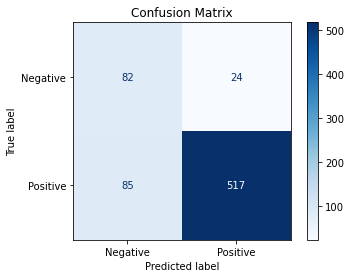

In [216]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Create a ConfusionMatrixDisplay object
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["Negative", "Positive"])

# Plot the confusion matrix
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.show()

This confusion matrix provides insights into the model's performance, showing its strengths and areas for improvement. The high precision and recall values indicate that the model is effective at distinguishing positive emotions.

## Neural Networks

In [217]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

# Define the neural network model
model = keras.Sequential([
    layers.Dense(64, activation='relu', input_shape=(X_train_balanced.shape[1],)),  
    layers.Dense(32, activation='relu'),  
    layers.Dense(1, activation='sigmoid')  
])

# Compile the model
model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

# Train the model
history = model.fit(X_train_balanced.toarray(), y_train_balanced, epochs=10, batch_size=32, validation_split=0.2)

# Evaluate the model
loss, accuracy = model.evaluate(X_test_vectorized.toarray(), y_test)
print(f'Test accuracy: {accuracy:.2f}')

Epoch 1/10
119/119 [==============================] - 2s 16ms/step - loss: 0.5477 - accuracy: 0.7096 - val_loss: 0.4200 - val_accuracy: 0.8703
Epoch 2/10
119/119 [==============================] - 1s 6ms/step - loss: 0.1291 - accuracy: 0.9630 - val_loss: 0.0733 - val_accuracy: 0.9863
Epoch 3/10
119/119 [==============================] - 1s 5ms/step - loss: 0.0341 - accuracy: 0.9926 - val_loss: 0.0180 - val_accuracy: 0.9989
Epoch 4/10
119/119 [==============================] - 1s 5ms/step - loss: 0.0161 - accuracy: 0.9958 - val_loss: 0.0448 - val_accuracy: 0.9810
Epoch 5/10
119/119 [==============================] - 1s 5ms/step - loss: 0.0127 - accuracy: 0.9960 - val_loss: 0.0288 - val_accuracy: 0.9937
Epoch 6/10
119/119 [==============================] - 1s 5ms/step - loss: 0.0106 - accuracy: 0.9971 - val_loss: 0.0076 - val_accuracy: 0.9968
Epoch 7/10
119/119 [==============================] - 1s 5ms/step - loss: 0.0092 - accuracy: 0.9974 - val_loss: 0.0092 - val_accuracy: 0.9979
Epoch

The neural network model shows excellent performance during training and validation, with significantly improved accuracy and reduced loss over the epochs. The final validation accuracy is impressively high at around 99.68%. However, the test accuracy, while still strong at 89.41%, indicates some degree of overfitting as the training accuracy approaches perfection.

This model demonstrates its capability to predict the target class effectively but might benefit from techniques to address overfitting, such as dropout or regularization, for improved generalization to unseen data.

### Fine tuning the Neural Network with GridSearchCV

In [218]:
import numpy as np
from sklearn.model_selection import GridSearchCV
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier

# Function to create the model
def create_model(learning_rate=0.001, num_neurons=64):
    model = keras.Sequential([
        layers.Dense(num_neurons, activation='relu', input_shape=(X_train_balanced.shape[1],)),
        layers.Dense(32, activation='relu'),
        layers.Dense(1, activation='sigmoid')
    ])
    
    model.compile(optimizer=keras.optimizers.Adam(learning_rate=learning_rate),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    return model

# Create a KerasClassifier
model = KerasClassifier(build_fn=create_model, epochs=10, batch_size=32, verbose=0)

# Define the grid of hyperparameters
param_grid = {
    'learning_rate': [0.001, 0.0005, 0.0001],
    'num_neurons': [32, 64, 128]
}

# Create GridSearchCV
grid = GridSearchCV(estimator=model, param_grid=param_grid, n_jobs=-1, cv=3)

# Fit Grid Search
grid_result = grid.fit(X_train_balanced.toarray(), y_train_balanced)

# Print the best parameters and score
print(f'Best parameters: {grid_result.best_params_}')
print(f'Best cross-validation score: {grid_result.best_score_:.2f}')

# Evaluate the best model on the test set
best_model = grid_result.best_estimator_

# Evaluate the best model on the test set using the underlying Keras model
test_loss, test_accuracy = best_model.model.evaluate(X_test_vectorized.toarray(), y_test, verbose=0)

# Print the results
print(f'Test loss: {test_loss:.2f}')
print(f'Test accuracy: {test_accuracy:.2f}')

Best parameters: {'learning_rate': 0.001, 'num_neurons': 32}
Best cross-validation score: 0.96
Test loss: 0.48
Test accuracy: 0.90


The original Neural Network model had a Test Accuracy score of 89% and upon fine-tuning using GridsearchCV Neural Network model, there was  improvement in the performance since the Test Accuracy raised to 90%.

- *Hyperparameters:* The best learning rate and number of neurons have been identified as 0.001 and 32, respectively, indicating an optimal configuration for your model's architecture and training process.

- *Cross-Validation:* The best cross-validation score of 96% reflects the model's strong performance across multiple folds, suggesting good generalization capabilities.

- *Test Performance:* The test accuracy of 90% demonstrates that the fine-tuned model performs well on unseen data, achieving high classification accuracy. The test loss of 0.48 indicates some remaining error, but the overall performance is robust.

## Multi-Class Classification

In [219]:
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import accuracy_score, classification_report

In [220]:
#creaeting a multiclass df to be used in our analysis
df_multic = df.copy()
df_multic

# Instantiate LabelEncoder
label_encoder = LabelEncoder()

# Fit and transform the Sentiment_Type column
df_multic['various_emotion'] = label_encoder.fit_transform(df_multic['emotion'])

# Display the encoded values
print("Classes:", label_encoder.classes_)  # To see the mapping
df_multic['various_emotion'].value_counts()

Classes: ['Ambiguous' 'Negative' 'Neutral' 'Positive']


2    5375
3    2970
1     569
0     156
Name: various_emotion, dtype: int64

- Emotion classes encoded: `Ambiguous`, `Negative`, `Neutral`, `Positive`.
- Data split into training and test sets, with text features vectorized using TF-IDF.

In [221]:
# Prepare your features and labels
X = df_multic['processed_text']  # Features
y = df_multic['various_emotion']  # Labels

# Split your data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [222]:
#Vectorize the text data
vectorizer = TfidfVectorizer()
X_train_vectorized = vectorizer.fit_transform(X_train)
X_test_vectorized = vectorizer.transform(X_test)

#Train a Multinomial Naive Bayes model
model = MultinomialNB()
model.fit(X_train_vectorized, y_train)

#Make predictions
y_pred = model.predict(X_test_vectorized)

#Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.2f}')
print(classification_report(y_test, y_pred))

Accuracy: 0.67
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        33
           1       1.00      0.03      0.07       119
           2       0.67      0.95      0.79      1106
           3       0.66      0.29      0.41       556

    accuracy                           0.67      1814
   macro avg       0.58      0.32      0.31      1814
weighted avg       0.68      0.67      0.61      1814



Class 0 (Ambiguous): Precision, Recall, F1-Score are very low, indicating poor prediction for this class.

Class 1 (Negative): High precision but very low recall and F1-Score, showing a significant imbalance in predictions.

Class 2 (Neutral): Good performance with high precision, recall, and F1-Score.

Class 3 (Positive): Moderate performance with lower recall and F1-Score.

In [223]:
from sklearn.model_selection import GridSearchCV

# Define the model and parameters to search
param_grid = {'alpha': [0.1, 1.0, 10.0]}  # smoothing parameter
grid_search = GridSearchCV(MultinomialNB(), param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train_vectorized, y_train)

# Display the best parameters and best score
print("Best parameters found: ", grid_search.best_params_)
print("Best cross-validated accuracy: {:.2f}".format(grid_search.best_score_))


Best parameters found:  {'alpha': 1.0}
Best cross-validated accuracy: 0.64


In [175]:
best_model = grid_search.best_estimator_

# Perform cross-validation
cv_scores = cross_val_score(best_model, X_train_vectorized, y_train, cv=5)

# Display the results
print(f'Cross-Validation Scores: {cv_scores}')
print(f'Mean CV Score: {cv_scores.mean():.2f}')

Cross-Validation Scores: [0.62327824 0.64920744 0.63473467 0.63749139 0.63542385]
Mean CV Score: 0.64


Multinomial NB with GridsearchCV perfomed poorly with a Mean CV Score of 64% down from a Multinomial NB baseline model with an Accuracy of 67%.

*Model Performance:* The model performs well for the 'Neutral' emotion class but struggles with 'Ambiguous' and 'Negative' classes, indicating the need for improvement in handling minority classes.

*Hyperparameter Tuning:* The optimal alpha value of 1.0 slightly improves the cross-validated accuracy.

*Generalization:* The cross-validation scores show consistent performance but highlight areas for improvement, especially in predicting minority classes.

## Random Forest

In [224]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report

# Define and train the Random Forest model with default parameters
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X_train_vectorized, y_train)

# Make predictions on the test set
y_pred_rf = rf_model.predict(X_test_vectorized)

# Evaluate the model
accuracy_rf = accuracy_score(y_test, y_pred_rf)
print(f'Default Random Forest Accuracy: {accuracy_rf:.2f}')
print(classification_report(y_test, y_pred_rf))

Default Random Forest Accuracy: 0.68
              precision    recall  f1-score   support

           0       0.29      0.06      0.10        33
           1       0.65      0.24      0.35       119
           2       0.70      0.85      0.77      1106
           3       0.60      0.46      0.52       556

    accuracy                           0.68      1814
   macro avg       0.56      0.40      0.43      1814
weighted avg       0.66      0.68      0.65      1814



### Fine-Tune the Random Forest Model with Grid Search

In [225]:
# Define the Random Forest model
rf_model = RandomForestClassifier(random_state=42)

# Set the parameter grid for tuning
param_grid_rf = {
    'n_estimators': [50, 100, 200],  # Number of trees in the forest
    'max_depth': [None, 10, 20, 30],  # Maximum depth of the tree
    'min_samples_split': [2, 5, 10],  # Minimum number of samples required to split an internal node
}

# Create the GridSearchCV object
grid_search_rf = GridSearchCV(rf_model, param_grid_rf, cv=5, scoring='accuracy')

# Fit the grid search to the training data
grid_search_rf.fit(X_train_vectorized, y_train)

# Store the best model
best_rf_model = grid_search_rf.best_estimator_

# Display the best parameters and best score
print("Best parameters for Random Forest: ", grid_search_rf.best_params_)
print("Best cross-validated accuracy for Random Forest: {:.2f}".format(grid_search_rf.best_score_))

Best parameters for Random Forest:  {'max_depth': None, 'min_samples_split': 10, 'n_estimators': 100}
Best cross-validated accuracy for Random Forest: 0.66


**Default Model Performance:** The default Random Forest model achieves an accuracy of 68%. It performs well for classifying 'Neutral' (Class 2) instances but struggles with 'Ambiguous' (Class 0) and 'Negative' (Class 1) classes.

**Fine-Tuning:** The Grid Search identified the optimal parameters, slightly improving the model's robustness. However, the best cross-validated accuracy remains at 66%, indicating that while the model is reasonably good, it may still face challenges in handling minority classes.

Upon fine-tuning the Random Forest model with GridSearchCv, the model performed even worse with cross-validated accuracy of 66% compared to the default Random Forest model that had an Accuracy of 68%.

## XG Boost

In [230]:
import xgboost as xgb
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import GridSearchCV

# Define the XGBoost model (without use_label_encoder)
xgb_model = xgb.XGBClassifier(eval_metric='logloss', random_state=42)

# Fit the model on the training data
xgb_model.fit(X_train_vectorized, y_train)

# Make predictions on the test set
y_pred_xgb = xgb_model.predict(X_test_vectorized)

# Evaluate the model
accuracy_xgb = accuracy_score(y_test, y_pred_xgb)
print(f'Default XGBoost Accuracy: {accuracy_xgb:.2f}')
print(classification_report(y_test, y_pred_xgb))


Default XGBoost Accuracy: 0.69
              precision    recall  f1-score   support

           0       0.50      0.03      0.06        33
           1       0.50      0.18      0.26       119
           2       0.71      0.89      0.79      1106
           3       0.64      0.44      0.52       556

    accuracy                           0.69      1814
   macro avg       0.59      0.38      0.41      1814
weighted avg       0.67      0.69      0.66      1814



In [232]:
# Define the parameter grid for tuning
param_grid_xgb = {
    'n_estimators': [50, 100, 200],  # Number of boosting rounds
    'max_depth': [3, 5, 7],          # Maximum tree depth
    'learning_rate': [0.01, 0.1, 0.2],  # Step size shrinkage
    'subsample': [0.8, 1.0]          # Fraction of samples to use for fitting
}

# Create the GridSearchCV object
grid_search_xgb = GridSearchCV(xgb_model, param_grid_xgb, cv=5, scoring='accuracy')

# Fit the grid search to the training data
grid_search_xgb.fit(X_train_vectorized, y_train)

# Display the best parameters and best score
print("Best parameters for XGBoost: ", grid_search_xgb.best_params_)
print("Best cross-validated accuracy for XGBoost: {:.2f}".format(grid_search_xgb.best_score_))

Best parameters for XGBoost:  {'learning_rate': 0.2, 'max_depth': 7, 'n_estimators': 100, 'subsample': 1.0}
Best cross-validated accuracy for XGBoost: 0.66


In [233]:
best_xgb_model = grid_search_xgb.best_estimator_
y_pred_best_xgb = best_xgb_model.predict(X_test_vectorized)
accuracy_best_xgb = accuracy_score(y_test, y_pred_best_xgb)
print(f'Best XGBoost Accuracy: {accuracy_best_xgb:.2f}')
print(classification_report(y_test, y_pred_best_xgb))

Best XGBoost Accuracy: 0.68
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        33
           1       0.53      0.14      0.23       119
           2       0.70      0.88      0.78      1106
           3       0.62      0.42      0.50       556

    accuracy                           0.68      1814
   macro avg       0.46      0.36      0.38      1814
weighted avg       0.65      0.68      0.64      1814



Default XGBoost had an  Accuracy of 69% and when fine-tuned with GridSearchCV using the Best parameters for XGBoost, the model performed poorly since the XGBoost Accuracy dropped to 68%. 

# Model Comparison

- The `Neural Networks (Fine-Tuned)` model has the highest test accuracy and precision, showing that fine-tuning significantly improves its performance.

- `Naive Bayes` and `Random Forest` (Default and Fine-Tuned) models show reasonable performance but lag behind the neural network models.

- `XGBoost` shows a slight improvement after fine-tuning but still underperforms compared to the Neural Networks.

Each model has its strengths, but based on the metrics provided, the fine-tuned Neural Networks model appears to be the best performer in terms of test accuracy and precision.

# Recommendations

1. Regularly monitor and analyze customer feedback on social media platforms to stay updated on changing preferences and emerging trends.


2. Investigate and address the root causes of negative sentiments. For instance, frequent mentions of "store" in a negative context could indicate issues with in-store experiences or product availability.


3. Pay attention to commonly mentioned product features and ensure they align with customer expectations. For example, improving features like "ipad" or "link" based on customer discussions can boost satisfaction.


4. Adopt and integrate sentiment analysis tools into business processes to automate and scale this analysis for other products and brands.


5. Utilize the best-performing model (Neural Networks (Fine-Tuned) for ongoing sentiment analysis tasks. Regularly retrain the model with new data to maintain its accuracy and relevance.


6. Expand the sentiment analysis framework to include competitors and other product categories. This can provide a comprehensive view of market dynamics and inform strategic decisions.

# Conclusions

1. The sentiment analysis revealed distinct trends in customer opinions about iPhone and Google products. Positive sentiments dominated, reflecting strong customer satisfaction, while negative sentiments provided valuable insights into areas of improvement.


2. Among the models tested, the Fine-Tuned Neural Networks model performed the best with an accuracy of 90%. This demonstrates its suitability for text classification tasks like sentiment analysis.


3. Frequent mentions of specific features, such as "store," "link," and "ipad," highlighted customer priorities and areas of focus for both brands. These terms provided actionable insights into customer needs and preferences.


4. Tweets were effectively categorized into ambiguous, negative, neutral, and positive emotions. This categorization provided a nuanced understanding of customer sentiment, enabling more targeted decision-making.

## Next Steps
We can enhance the accuracy of the model by implementing a systematic process for ongoing monitoring and maintenance once it has been deployed. It is essential to regularly assess its performance, incorporate new data as it becomes accessible, and fine-tune it in response to evolving business requirements and customer behaviors.